In [35]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from kmodes.kprototypes import KPrototypes

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import plotly.offline as pyo
pyo.init_notebook_mode()
import plotly.graph_objs as go
from plotly import tools
from plotly.subplots import make_subplots
import plotly.offline as py
import plotly.express as px

import warnings
warnings.filterwarnings("ignore") 
%matplotlib inline

pd.set_option('display.max_columns', None)

In [36]:
data = pd.read_csv(r'C:\Users\AtulPoddar\OneDrive - TheMathCompany Private Limited\Documents\Aspen Dental\UncontrollableFactors-AprilData (1).csv')
data.columns

Index(['FacilityCode', 'facility_name', 'Clusters', 'Office Class',
       'FacilityOpeningDate', 'Current Working Year', '% AfricanAmerican',
       '% Hispanic', '% Uninsured', 'Median Normalised Income',
       'External comp Within 20 Miles', 'High School Graduates (5-7-10m)',
       'NPA Benchmarks', 'Fast Cas. Mexican Burger (.25m)',
       'Shop. Center GLA (1.5m)', 'Big Box Retailers (1.5m)',
       'Dental Chains (1m)', 'Delta Dental per 10K (10m)', '% Medicaid (10m)',
       'Years in DMA', 'Office Sq.Ft', 'Internal Competition',
       'TotalRevenuePerHour', 'EBITDAPerHour'],
      dtype='object')

In [37]:
data.shape

(892, 24)

In [38]:
rhr = data['TotalRevenuePerHour'] 
rhr

0      $310
1      $388
2      $403
3      $309
4      $384
       ... 
887    $374
888    $248
889    $335
890    $277
891    $289
Name: TotalRevenuePerHour, Length: 892, dtype: object

In [39]:
df = data.drop(['FacilityCode', 'facility_name', 'Clusters', 'FacilityOpeningDate','EBITDAPerHour'], axis=1)

In [40]:
df['High School Graduates (5-7-10m)'] = df['High School Graduates (5-7-10m)'].str.replace('%','').astype(np.float64)
df['% Medicaid (10m)'] = df['% Medicaid (10m)'].str.replace('%','').astype(np.float64)
df['TotalRevenuePerHour'] = df['TotalRevenuePerHour'].str.replace('$', '').astype(np.int64)
df['% Hispanic'] = np.where(df['% Hispanic'] > 1, (data['% Hispanic']/100).round(2), data['% Hispanic'])

In [41]:
df.head()

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour
0,Suburban,22,0.15,0.20,0.05,76467.64,463.0,38.5,7.7,0.0,1781005.0,1.0,0.0,3.840141,21.9,0.000000,3750.0,7.0,310
1,Suburban,22,0.07,0.18,0.04,66714.48,293.0,43.5,7.5,0.0,895999.0,3.0,0.0,1.854511,22.2,0.000000,4000.0,7.0,388
2,Urban,22,0.02,0.04,0.04,72641.37,289.0,44.3,6.8,1.0,934543.0,0.0,0.0,2.590615,21.9,0.000000,3952.0,6.0,403
3,Most Urban,22,0.15,0.19,0.12,93421.40,452.0,33.1,5.1,0.0,0.0,0.0,0.0,3.742308,19.5,9.438356,3687.0,4.0,309
4,Suburban,19,0.07,0.14,0.12,133906.92,471.0,30.2,4.6,0.0,0.0,0.0,0.0,4.125406,9.9,11.652055,3138.0,3.0,384


In [42]:
def remove_percent(col):
    col = col.apply(lambda x : str(x)[:-1] if str(x)[:-1].replace('.', '', 1).isnumeric() else np.nan).astype(np.float64)
    col = col/100
    col = col.round(2)
    return col

In [43]:
col_lst = ['High School Graduates (5-7-10m)', '% Medicaid (10m)']
df[col_lst] = df[col_lst].apply(remove_percent)

In [44]:
df.head()

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour
0,Suburban,22,0.15,0.20,0.05,76467.64,463.0,0.38,7.7,0.0,1781005.0,1.0,0.0,3.840141,0.21,0.000000,3750.0,7.0,310
1,Suburban,22,0.07,0.18,0.04,66714.48,293.0,0.43,7.5,0.0,895999.0,3.0,0.0,1.854511,0.22,0.000000,4000.0,7.0,388
2,Urban,22,0.02,0.04,0.04,72641.37,289.0,0.44,6.8,1.0,934543.0,0.0,0.0,2.590615,0.21,0.000000,3952.0,6.0,403
3,Most Urban,22,0.15,0.19,0.12,93421.40,452.0,0.33,5.1,0.0,0.0,0.0,0.0,3.742308,0.19,9.438356,3687.0,4.0,309
4,Suburban,19,0.07,0.14,0.12,133906.92,471.0,0.30,4.6,0.0,0.0,0.0,0.0,4.125406,0.09,11.652055,3138.0,3.0,384


In [45]:
df.isna().sum()

Office Class                        0
Current Working Year                0
% AfricanAmerican                   1
% Hispanic                          1
% Uninsured                         1
Median Normalised Income            1
External comp Within 20 Miles       1
High School Graduates (5-7-10m)     1
NPA Benchmarks                      0
Fast Cas. Mexican Burger (.25m)     1
Shop. Center GLA (1.5m)             1
Big Box Retailers (1.5m)            1
Dental Chains (1m)                  1
Delta Dental per 10K (10m)          1
% Medicaid (10m)                    1
Years in DMA                        1
Office Sq.Ft                       32
Internal Competition                1
TotalRevenuePerHour                 0
dtype: int64

In [46]:
df['Shop. Center GLA (1.5m)'] = (df['Shop. Center GLA (1.5m)']/100000).round(2)
df['Median Normalised Income'] = (df['Median Normalised Income']/10000).round(2)
df['Office Sq.Ft'] = (df['Office Sq.Ft']/1000).round(2)
df['External comp Within 20 Miles'] = (df['External comp Within 20 Miles']/20).round(2)

In [47]:
df.head()

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour
0,Suburban,22,0.15,0.20,0.05,7.65,23.15,0.38,7.7,0.0,17.81,1.0,0.0,3.840141,0.21,0.000000,3.75,7.0,310
1,Suburban,22,0.07,0.18,0.04,6.67,14.65,0.43,7.5,0.0,8.96,3.0,0.0,1.854511,0.22,0.000000,4.00,7.0,388
2,Urban,22,0.02,0.04,0.04,7.26,14.45,0.44,6.8,1.0,9.35,0.0,0.0,2.590615,0.21,0.000000,3.95,6.0,403
3,Most Urban,22,0.15,0.19,0.12,9.34,22.60,0.33,5.1,0.0,0.00,0.0,0.0,3.742308,0.19,9.438356,3.69,4.0,309
4,Suburban,19,0.07,0.14,0.12,13.39,23.55,0.30,4.6,0.0,0.00,0.0,0.0,4.125406,0.09,11.652055,3.14,3.0,384


In [48]:
df.loc[[733]]

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour
733,Not Set,1,NaN,NaN,NaN,NaN,NaN,NaN,9.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,85


In [49]:
df.shape

(892, 19)

In [50]:
df.isna().sum()

Office Class                        0
Current Working Year                0
% AfricanAmerican                   1
% Hispanic                          1
% Uninsured                         1
Median Normalised Income            1
External comp Within 20 Miles       1
High School Graduates (5-7-10m)     1
NPA Benchmarks                      0
Fast Cas. Mexican Burger (.25m)     1
Shop. Center GLA (1.5m)             1
Big Box Retailers (1.5m)            1
Dental Chains (1m)                  1
Delta Dental per 10K (10m)          1
% Medicaid (10m)                    1
Years in DMA                        1
Office Sq.Ft                       32
Internal Competition                1
TotalRevenuePerHour                 0
dtype: int64

In [51]:
df['Office Sq.Ft'].fillna(df['Office Sq.Ft'].median(), inplace=True)

In [52]:
df.isna().sum()

Office Class                       0
Current Working Year               0
% AfricanAmerican                  1
% Hispanic                         1
% Uninsured                        1
Median Normalised Income           1
External comp Within 20 Miles      1
High School Graduates (5-7-10m)    1
NPA Benchmarks                     0
Fast Cas. Mexican Burger (.25m)    1
Shop. Center GLA (1.5m)            1
Big Box Retailers (1.5m)           1
Dental Chains (1m)                 1
Delta Dental per 10K (10m)         1
% Medicaid (10m)                   1
Years in DMA                       1
Office Sq.Ft                       0
Internal Competition               1
TotalRevenuePerHour                0
dtype: int64

In [53]:
df.shape

(892, 19)

In [54]:
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)

In [55]:
df.shape

(891, 19)

In [28]:
# importing sweetviz
import sweetviz as sv
#analyzing the dataset
report = sv.analyze(df)
#display the report
report.show_html('Un-Controllable Factors.html')

                                             |                                             | [  0%]   00:00 ->…

Report Un-Controllable Factors.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [29]:
#df['% Hispanic'] = np.where(df['% Hispanic']==17.8, 0.18, df['% Hispanic'])
#df['% Hispanic'] = np.where(df['% Hispanic']==2.2, 0.02, df['% Hispanic'])

In [56]:
df.describe(percentiles=[.80,.85,.90,.95,.96,.97,.98,.99,.999])

,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour
count,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.000000,891.00000,891.000000,891.000000
mean,7.909091,0.122480,0.102705,0.104860,7.279360,10.979966,0.388631,9.225701,0.508418,9.900741,1.461279,0.379349,2.899476,0.163614,3.901979,3.49954,3.040404,333.831650
std,5.228448,0.118671,0.114201,0.046694,1.361514,12.045852,0.088526,2.222627,0.722579,7.347413,1.023002,0.688411,1.005813,0.057490,4.810489,0.44975,2.188978,94.396086
min,1.000000,0.000000,0.010000,0.020000,4.240000,0.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,23.000000
50%,7.000000,0.080000,0.060000,0.100000,7.050000,6.600000,0.390000,9.100000,0.000000,8.430000,1.000000,0.000000,2.923139,0.160000,2.071233,3.50000,2.000000,323.000000
80%,12.000000,0.190000,0.150000,0.140000,8.320000,18.550000,0.460000,11.100000,1.000000,15.910000,2.000000,1.000000,3.658350,0.210000,7.632877,3.60000,5.000000,411.000000
85%,13.000000,0.240000,0.180000,0.160000,8.715000,22.450000,0.470000,11.500000,1.000000,17.515000,3.000000,1.000000,3.896057,0.220000,8.895890,3.72000,5.000000,429.000000
90%,15.000000,0.290000,0.230000,0.170000,9.140000,28.250000,0.500000,12.000000,2.000000,20.590000,3.000000,1.000000,4.203355,0.240000,10.276712,3.80000,6.000000,455.000000
95%,18.000000,0.390000,0.340000,0.190000,9.855000,36.000000,0.520000,13.150000,2.000000,23.820000,3.000000,2.000000,4.556792,0.260000,13.526027,4.00000,7.000000,489.500000
96%,19.000000,0.400000,0.390000,0.200000,10.034000,38.940000,0.530000,13.740000,2.000000,24.806000,3.000000,2.000000,4.658837,0.270000,14.441644,4.03800,8.000000,506.800000


In [57]:
df.isna().sum()

Office Class                       0
Current Working Year               0
% AfricanAmerican                  0
% Hispanic                         0
% Uninsured                        0
Median Normalised Income           0
External comp Within 20 Miles      0
High School Graduates (5-7-10m)    0
NPA Benchmarks                     0
Fast Cas. Mexican Burger (.25m)    0
Shop. Center GLA (1.5m)            0
Big Box Retailers (1.5m)           0
Dental Chains (1m)                 0
Delta Dental per 10K (10m)         0
% Medicaid (10m)                   0
Years in DMA                       0
Office Sq.Ft                       0
Internal Competition               0
TotalRevenuePerHour                0
dtype: int64

In [58]:
# Capping att 99-percentile
df.iloc[:,1:] = np.where(df.iloc[:,1:]>df.iloc[:,1:].quantile(0.99), df.iloc[:,1:].quantile(0.99), df.iloc[:,1:])

In [59]:
rev = df.copy()

In [60]:
rev.head()

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour
0,Suburban,22.0,0.15,0.20,0.05,7.650,23.15,0.38,7.7,0.0,17.81,1.0,0.0,3.840141,0.21,0.000000,3.75,7.0,310.0
1,Suburban,22.0,0.07,0.18,0.04,6.670,14.65,0.43,7.5,0.0,8.96,3.0,0.0,1.854511,0.22,0.000000,4.00,7.0,388.0
2,Urban,22.0,0.02,0.04,0.04,7.260,14.45,0.44,6.8,1.0,9.35,0.0,0.0,2.590615,0.21,0.000000,3.95,6.0,403.0
3,Most Urban,22.0,0.15,0.19,0.12,9.340,22.60,0.33,5.1,0.0,0.00,0.0,0.0,3.742308,0.19,9.438356,3.69,4.0,309.0
4,Suburban,19.0,0.07,0.14,0.12,11.061,23.55,0.30,4.6,0.0,0.00,0.0,0.0,4.125406,0.09,11.652055,3.14,3.0,384.0


In [61]:
df = df.drop(['TotalRevenuePerHour'], axis=1)

In [62]:
df

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition
0,Suburban,22.0,0.15,0.20,0.05,7.650,23.15,0.38,7.7,0.0,17.81,1.0,0.0,3.840141,0.21,0.000000,3.75,7.0
1,Suburban,22.0,0.07,0.18,0.04,6.670,14.65,0.43,7.5,0.0,8.96,3.0,0.0,1.854511,0.22,0.000000,4.00,7.0
2,Urban,22.0,0.02,0.04,0.04,7.260,14.45,0.44,6.8,1.0,9.35,0.0,0.0,2.590615,0.21,0.000000,3.95,6.0
3,Most Urban,22.0,0.15,0.19,0.12,9.340,22.60,0.33,5.1,0.0,0.00,0.0,0.0,3.742308,0.19,9.438356,3.69,4.0
4,Suburban,19.0,0.07,0.14,0.12,11.061,23.55,0.30,4.6,0.0,0.00,0.0,0.0,4.125406,0.09,11.652055,3.14,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,Rural,10.0,0.10,0.14,0.07,7.960,10.00,0.41,8.6,0.0,7.38,1.0,1.0,1.625645,0.17,2.301370,3.20,4.0
887,Rural,10.0,0.09,0.04,0.14,7.900,6.25,0.42,7.4,0.0,1.82,0.0,0.0,3.912135,0.17,0.882192,3.20,2.0
888,Most Urban,10.0,0.06,0.38,0.12,6.160,56.74,0.38,6.7,2.0,11.80,2.0,1.0,3.156912,0.23,2.953425,3.35,9.0
889,Suburban,10.0,0.12,0.15,0.06,7.140,6.90,0.40,10.4,0.0,14.69,1.0,0.0,1.955790,0.20,2.665753,3.30,4.0


In [ ]:
#trans = MinMaxScaler()
#data1 = trans.fit_transform(df)

### Base K-ProtoType Model

In [63]:
# scaler = StandardScaler()
# cols = df.columns.to_list()[1:]

df_scaled = df.copy()
# df_scaled[cols] = scaler.fit_transform(df_scaled[cols])
# df_scaled

In [64]:
# Convert dataframe to matrix
dfMatrix = df_scaled.to_numpy()

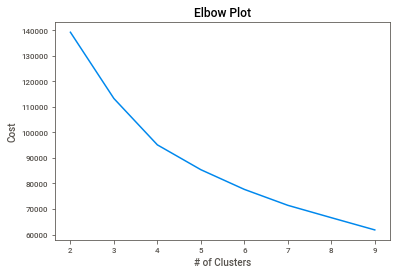

In [65]:
# Choose optimal K using Elbow method
cost = []
for cluster in range(2, 10):
    kprototype = KPrototypes(n_jobs = -1, n_clusters = cluster, init = 'Huang', random_state = 42)
    kprototype.fit_predict(dfMatrix, categorical = [0])
    cost.append(kprototype.cost_)
    
sns.lineplot(range(2,10), cost)
plt.xlabel("# of Clusters")
plt.ylabel("Cost")
plt.title("Elbow Plot")
plt.show()

In [66]:
cost

[139214.0038754913,
 113264.08071464086,
 95108.76184343018,
 85381.36895629279,
 77672.9757690166,
 71434.66616601025,
 66589.4271065424,
 61800.384203399844]

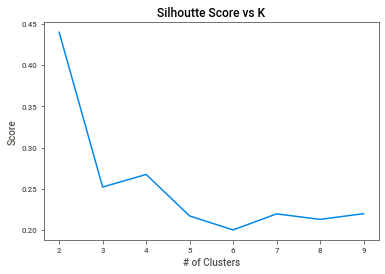

In [67]:
# Silhouette scores for different k values
scores = []
for cluster in range(2, 10):
    kprototype = KPrototypes(n_clusters = cluster, init = 'Huang', random_state = 42, n_jobs = -2, gamma=1.5, max_iter=500)
    kprototype.fit_predict(dfMatrix, categorical = [0])
    scores.append(silhouette_score(dfMatrix[:,1:], kprototype.labels_))
    
sns.lineplot(range(2,10), scores)
plt.xlabel("# of Clusters")
plt.ylabel("Score")
plt.title("Silhoutte Score vs K")
plt.show()

In [68]:
scores

[0.43972424470518917,
 0.2521851343923566,
 0.26747230393790866,
 0.2171594269739354,
 0.20024256252866124,
 0.21966316602623157,
 0.21302369398485296,
 0.21990027933099524]

In [69]:
# Fitting K-prototype to the dataset
kprototype = KPrototypes(n_clusters = 5, init = 'Huang', random_state = 42, n_jobs = -2, gamma=1.5, max_iter=500)
y_hat = kprototype.fit_predict(dfMatrix, categorical = [0])

In [70]:
df_clusters_1 = df.copy()
df_clusters_1['Cluster_ID'] = y_hat
df_clusters_1['Cluster_ID'].value_counts()

0    278
2    272
1    166
4    111
3     64
Name: Cluster_ID, dtype: int64

In [71]:
score = silhouette_score(df_clusters_1.iloc[:,1:], kprototype.labels_)
score

0.22805800796465633

In [72]:
k2prototype = KPrototypes(n_clusters = 4, init = 'Huang', random_state = 42, n_jobs = -2, gamma=1.5, max_iter=500)
y2_hat = k2prototype.fit_predict(dfMatrix, categorical = [0])

In [73]:
df_clusters_1 = df.copy()
df_clusters_1['Cluster_ID'] = y2_hat
df_clusters_1['Cluster_ID'].value_counts()

2    433
0    215
1    179
3     64
Name: Cluster_ID, dtype: int64

In [74]:
score = silhouette_score(df_clusters_1.iloc[:,1:], k2prototype.labels_)
score

0.2720002564167085

In [75]:
k2prototype = KPrototypes(n_clusters = 7, init = 'Huang', random_state = 42, n_jobs = -2, gamma=1.5, max_iter=500)
y2_hat = k2prototype.fit_predict(dfMatrix, categorical = [0])

In [76]:
df_clusters_1 = df.copy()
df_clusters_1['Cluster_ID'] = y2_hat
df_clusters_1['Cluster_ID'].value_counts()

6    245
5    244
4    124
2    107
3     76
1     61
0     34
Name: Cluster_ID, dtype: int64

In [77]:
score = silhouette_score(df_clusters_1.iloc[:,1:], k2prototype.labels_)
score

0.22898003820461565

In [81]:
#FOR 5 clusters
df_clusters2 = df.copy()
df_clusters2['Cluster_ID'] = y_hat
df_clusters2['TotalRevenuePerHour'] = rev['TotalRevenuePerHour']
# df_clusters = pd.concat([df_clusters, data[['TotalRevenuePerHour', 'EBITDAPerHour']]], axis = 1)
df_clusters2['Cluster_ID'].value_counts()

0    278
2    272
1    166
4    111
3     64
Name: Cluster_ID, dtype: int64

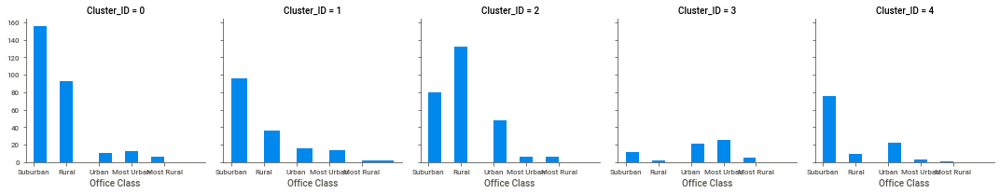

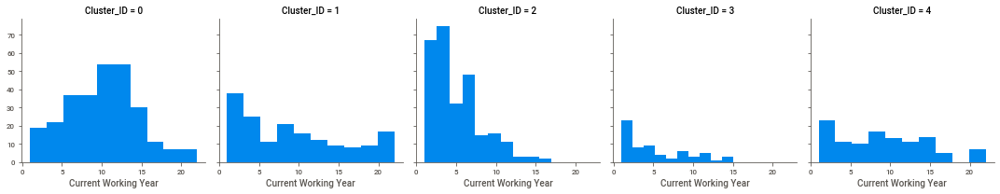

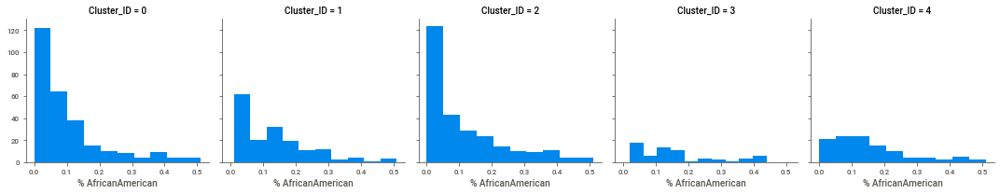

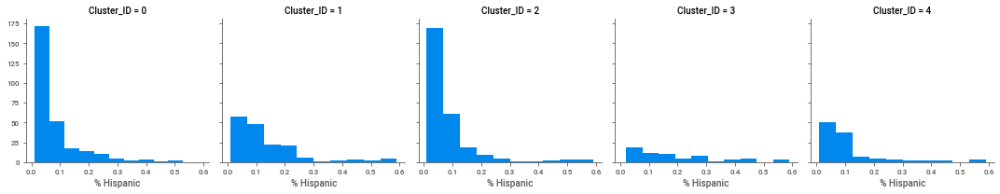

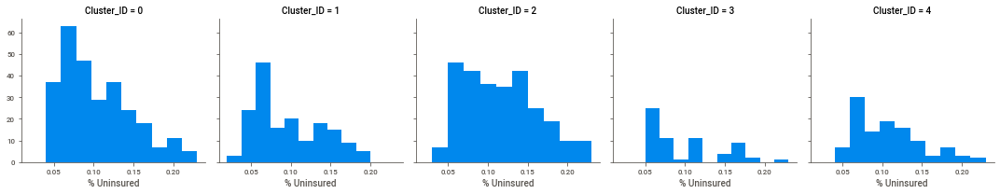

...

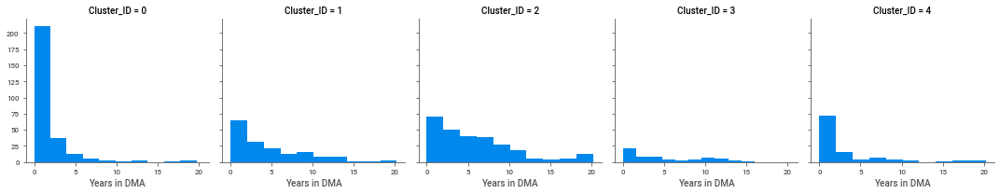

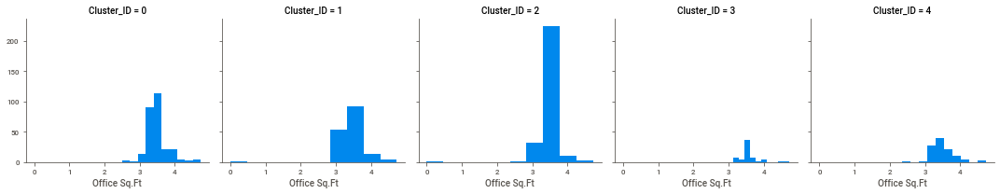

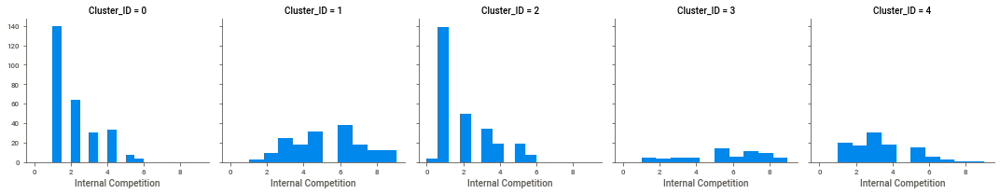

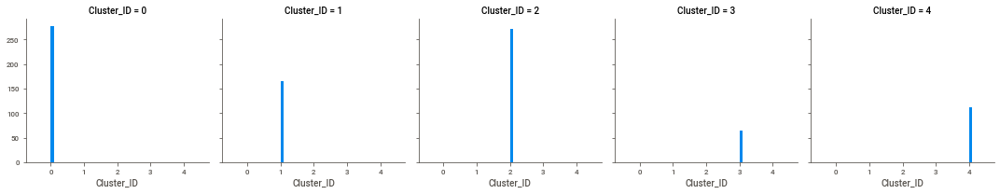

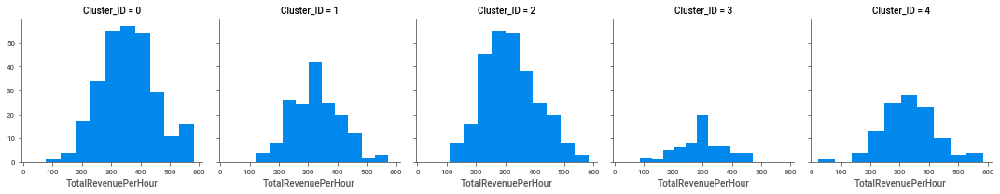

In [82]:
# sns.pairplot(df_clusters, hue='Cluster_ID', palette='dark')
for c in df_clusters2:
    grid = sns.FacetGrid(df_clusters2, col='Cluster_ID')
    grid.map(plt.hist, c)

In [ ]:
## sns.pairplot(df_clusters_1, hue='Cluster_ID', palette='dark')

In [38]:
#df = pd.concat([df, df_clusters_1['Cluster_ID'],rev['TotalRevenuePerHour']], axis = 1)

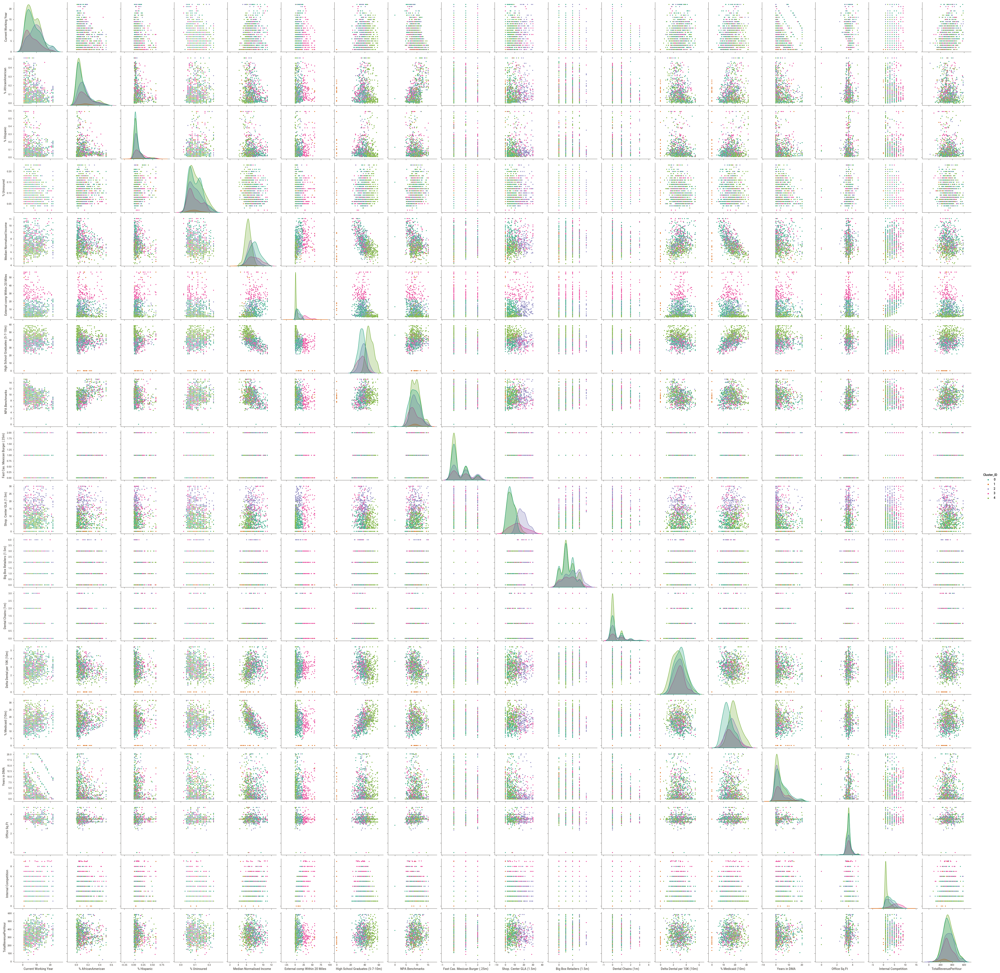

In [39]:
#sns.pairplot(df, hue='Cluster_ID', palette='Dark2', diag_kind='kde')

### PCA

In [78]:
df

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition
0,Suburban,22.0,0.15,0.20,0.05,7.650,23.15,0.38,7.7,0.0,17.81,1.0,0.0,3.840141,0.21,0.000000,3.75,7.0
1,Suburban,22.0,0.07,0.18,0.04,6.670,14.65,0.43,7.5,0.0,8.96,3.0,0.0,1.854511,0.22,0.000000,4.00,7.0
2,Urban,22.0,0.02,0.04,0.04,7.260,14.45,0.44,6.8,1.0,9.35,0.0,0.0,2.590615,0.21,0.000000,3.95,6.0
3,Most Urban,22.0,0.15,0.19,0.12,9.340,22.60,0.33,5.1,0.0,0.00,0.0,0.0,3.742308,0.19,9.438356,3.69,4.0
4,Suburban,19.0,0.07,0.14,0.12,11.061,23.55,0.30,4.6,0.0,0.00,0.0,0.0,4.125406,0.09,11.652055,3.14,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
886,Rural,10.0,0.10,0.14,0.07,7.960,10.00,0.41,8.6,0.0,7.38,1.0,1.0,1.625645,0.17,2.301370,3.20,4.0
887,Rural,10.0,0.09,0.04,0.14,7.900,6.25,0.42,7.4,0.0,1.82,0.0,0.0,3.912135,0.17,0.882192,3.20,2.0
888,Most Urban,10.0,0.06,0.38,0.12,6.160,56.74,0.38,6.7,2.0,11.80,2.0,1.0,3.156912,0.23,2.953425,3.35,9.0
889,Suburban,10.0,0.12,0.15,0.06,7.140,6.90,0.40,10.4,0.0,14.69,1.0,0.0,1.955790,0.20,2.665753,3.30,4.0


In [79]:
# PCA

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(df.select_dtypes(exclude='object'))
var = pca.explained_variance_ratio_

# Cumulative Explained Variance
cum_explained_var = []
for i in range(0, len(pca.explained_variance_ratio_)):
    if i == 0:
        cum_explained_var.append(pca.explained_variance_ratio_[i])
    else:
        cum_explained_var.append(pca.explained_variance_ratio_[i] + 
                                 cum_explained_var[i-1])

print(cum_explained_var)

[0.5698670153110936, 0.7788921089388239]


In [42]:
#Principal Components converted to a Data frame
principalDf  = pd.DataFrame(data = principalComponents, columns = ['PCA-1', 'PCA-2'])
principalDf.shape

(891, 2)

In [43]:
#Concatenating the PCAs with the categorical variable
finalDf_Cat = pd.concat([principalDf, df['Office Class']], axis = 1)
finalDf_Cat.dropna(inplace=True)

In [44]:
# Convert dataframe to matrix
X = finalDf_Cat.to_numpy()

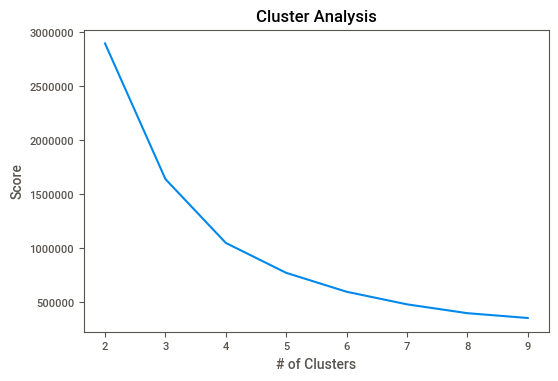

In [45]:
#Choosing optimal K value
cost = []
scores = []

for cluster in range(2,10):
    kproto = KPrototypes(n_clusters=cluster, init='Huang', random_state=42, n_jobs=-2, n_init=50) 
    kproto.fit_predict(X, categorical=[2])
    cost.append(kproto.cost_)
    scores.append(silhouette_score(X[:,:-1], kproto.labels_))
    
sns.lineplot(range(2,10), cost)
plt.xlabel("# of Clusters")
plt.ylabel("Score")
plt.title("Cluster Analysis")
plt.show()

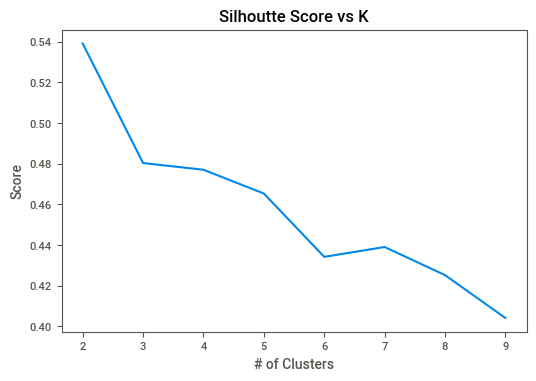

In [46]:
# Silhouette scores for different k values
sns.lineplot(range(2,10), scores)
plt.xlabel("# of Clusters")
plt.ylabel("Score")
plt.title("Silhoutte Score vs K")
plt.show()

In [47]:
scores

[0.5391816809379112,
 0.480308611295389,
 0.4769982889261355,
 0.46530767032938397,
 0.4341220781249515,
 0.4389554320681798,
 0.4251345000213949,
 0.4040131196123037]

## K=5

In [48]:
# Running K-Prototype clustering
kproto = KPrototypes(n_clusters=5, init='Huang', verbose=0, random_state=42,max_iter=20, n_init=50,n_jobs=-2,gamma=.25) 
clusters = kproto.fit_predict(X, categorical=[2])

In [49]:
df_clusters_pca = finalDf_Cat.copy()
df_clusters_pca['Cluster_ID'] = clusters
df_clusters_pca['Cluster_ID'].value_counts()

1    301
0    223
2    167
4    156
3     44
Name: Cluster_ID, dtype: int64

In [58]:
df = df.drop(['Cluster_ID'],axis = 1)

KeyError: "['Cluster_ID'] not found in axis"

In [59]:
df.head()

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,TotalRevenuePerHour,TotalRevenuePerHour
0,Suburban,22.0,0.15,0.20,0.05,7.650,23.15,38.5,7.7,0.0,17.81,1.0,0.0,3.840141,21.9,0.000000,3.75,7.0,310.0,310.0
1,Suburban,22.0,0.07,0.18,0.04,6.670,14.65,43.5,7.5,0.0,8.96,3.0,0.0,1.854511,22.2,0.000000,4.00,7.0,388.0,388.0
2,Urban,22.0,0.02,0.04,0.04,7.260,14.45,44.3,6.8,1.0,9.35,0.0,0.0,2.590615,21.9,0.000000,3.95,6.0,403.0,403.0
3,Most Urban,22.0,0.15,0.19,0.12,9.340,22.60,33.1,5.1,0.0,0.00,0.0,0.0,3.742308,19.5,9.438356,3.69,4.0,309.0,309.0
4,Suburban,19.0,0.07,0.14,0.12,11.061,23.55,30.2,4.6,0.0,0.00,0.0,0.0,4.125406,9.9,11.652055,3.14,3.0,384.0,384.0


In [60]:
df = pd.concat([df, df_clusters_pca['Cluster_ID']], axis=1)

In [62]:
df = df.drop(['TotalRevenuePerHour'],axis = 1)

In [63]:
df = pd.concat([df,rev['TotalRevenuePerHour']], axis=1)

In [64]:
df.head()

,Office Class,Current Working Year,% AfricanAmerican,% Hispanic,% Uninsured,Median Normalised Income,External comp Within 20 Miles,High School Graduates (5-7-10m),NPA Benchmarks,Fast Cas. Mexican Burger (.25m),Shop. Center GLA (1.5m),Big Box Retailers (1.5m),Dental Chains (1m),Delta Dental per 10K (10m),% Medicaid (10m),Years in DMA,Office Sq.Ft,Internal Competition,Cluster_ID,TotalRevenuePerHour
0,Suburban,22.0,0.15,0.20,0.05,7.650,23.15,38.5,7.7,0.0,17.81,1.0,0.0,3.840141,21.9,0.000000,3.75,7.0,1,310.0
1,Suburban,22.0,0.07,0.18,0.04,6.670,14.65,43.5,7.5,0.0,8.96,3.0,0.0,1.854511,22.2,0.000000,4.00,7.0,0,388.0
2,Urban,22.0,0.02,0.04,0.04,7.260,14.45,44.3,6.8,1.0,9.35,0.0,0.0,2.590615,21.9,0.000000,3.95,6.0,2,403.0
3,Most Urban,22.0,0.15,0.19,0.12,9.340,22.60,33.1,5.1,0.0,0.00,0.0,0.0,3.742308,19.5,9.438356,3.69,4.0,1,309.0
4,Suburban,19.0,0.07,0.14,0.12,11.061,23.55,30.2,4.6,0.0,0.00,0.0,0.0,4.125406,9.9,11.652055,3.14,3.0,0,384.0


In [53]:
Scene = dict(xaxis = dict(title  = 'PCA-1'),yaxis = dict(title  = 'PCA-2'),zaxis = dict(title  = 'Office Class'))

trace = go.Scatter3d(x=df_clusters_pca.iloc[:,0], y=df_clusters_pca.iloc[:,1], z=df_clusters_pca.iloc[:,2],
                     mode='markers',marker=dict(color = df_clusters_pca['Cluster_ID'], colorscale='Viridis',
                                                size = 10, line = dict(color = 'yellow',width = 5)))

layout = go.Layout(margin=dict(l=0,r=0),scene = Scene, height = 1000,width = 1000)
data = [trace]
fig = go.Figure(data = data, layout = layout)
fig.show()

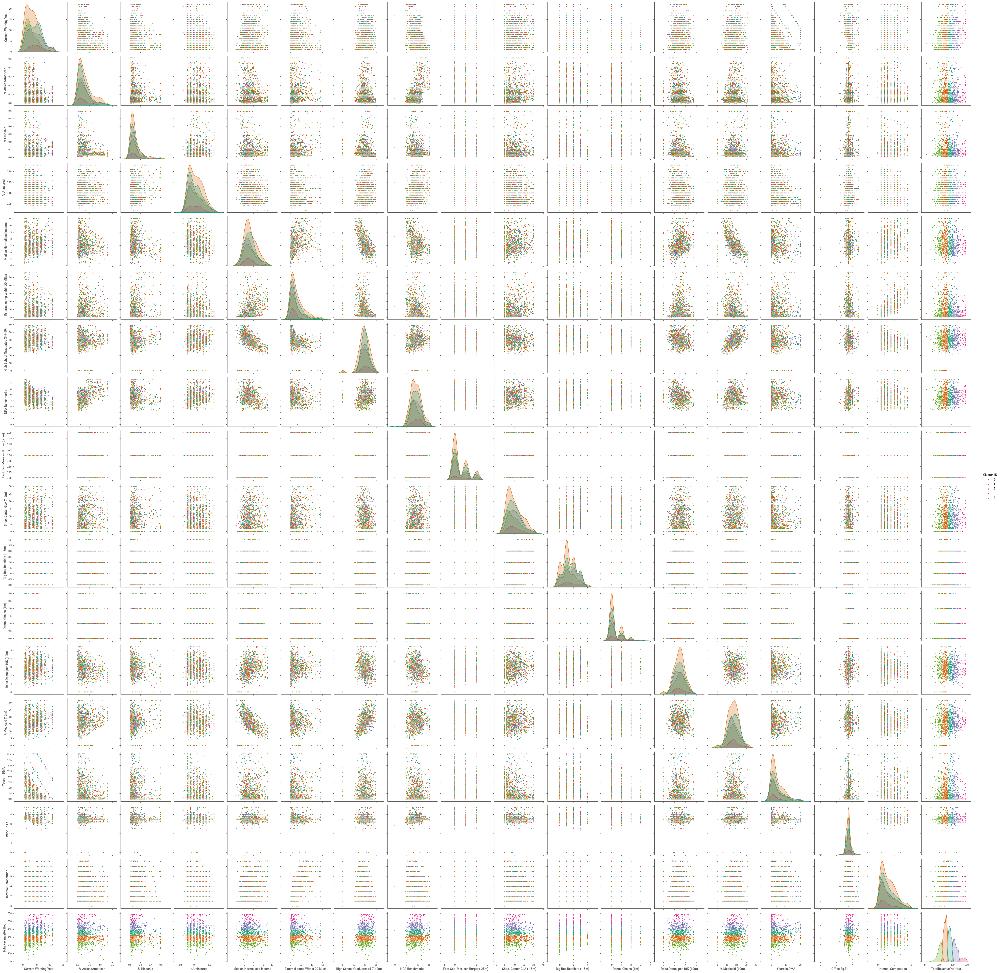

In [65]:
sns.pairplot(df, hue='Cluster_ID', palette='Dark2', diag_kind='kde')